In [263]:
import starry
import matplotlib.pyplot as plt
import numpy as np
import pymc3 as pm
import pymc3.math as pmm
import pymc3_ext as pmx
import exoplanet
from starry_process import StarryProcess, MCMCInterface
from starry_process.math import cho_factor, cho_solve
import starry_process 
import theano
theano.config.gcc__cxxflags += " -fexceptions"
theano.config.on_opt_error = "raise"
theano.tensor.opt.constant_folding
theano.graph.opt.EquilibriumOptimizer
import aesara_theano_fallback.tensor as tt
from theano.tensor.slinalg import cholesky
from corner import corner
import emcee
import time
import aesara
import timeit
from matplotlib.colors import Normalize
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
import os
from tqdm import tqdm
import arviz as az
import scipy
import matplotlib

starry.config.quiet = True
np.random.seed(1)

In [2]:
def Inclination(name, testval=30):
    """
    An isotropic distribution for inclination angles (in degrees).
    
    """
    def logp(x):
        return tt.log(np.pi / 180 * tt.sin(x * np.pi / 180))

    def random(*args, **kwargs):
        return tt.arccos(pm.Uniform.dist(0, 1).random(*args, **kwargs)) * 180 / np.pi

    return pm.DensityDist(
        name,
        logp,
        random=random,
        initval=testval,
    )


def Angle(*args, **kwargs):
    """
    A uniform distribution for angles in [-180, 180).
    
    """
    if kwargs.get("testval", None) is not None:
        kwargs["testval"] *= np.pi / 180
    return 180 / np.pi * pmx.Angle(*args, **kwargs)


# Shorthand for the usual Uniform distribution
Uniform = pm.Uniform

In [3]:
def generate(t, params, seed=1, error=1e-3, visualize=True):
    """
    Generate a synthetic light curve.
    
    """
    # Set up the system
    map = starry.Map(15, 2)
    map.inc = params["star.inc"]["truth"]
    map[1] = params["star.u1"]["truth"]
    map[2] = params["star.u2"]["truth"]
    star = starry.Primary(map, m=params["star.m"]["truth"]) # *** maybe also `r`
    planet = starry.Secondary(
        starry.Map(),
        inc=params["planet.inc"]["truth"],
        ecc=params["planet.ecc"]["truth"],
        Omega=params["planet.Omega"]["truth"],
        w=params["planet.w"]["truth"],
        porb=params["planet.porb"]["truth"],
        t0=params["planet.t0"]["truth"],
    )
    sys = starry.System(star, planet)
    xo, yo, zo = sys.position(t)
    xo = xo.eval()[1]
    yo = yo.eval()[1]
    zo = zo.eval()[1]
    
    # Get the flux design matrix
    theta = (360 * t / params["star.prot"]["truth"]) % 360
    A = map.design_matrix(
        theta=theta, xo=xo, yo=yo, zo=zo, ro=params["planet.r"]["truth"]
    ).eval()
    print(A.shape)
    
    # *** Draw 1 sample from the GP
    np.random.seed(seed)
    sp = StarryProcess(
        mu=params["gp.mu"]["truth"],
        sigma=params["gp.sigma"]["truth"],
        r=params["gp.r"]["truth"],
        c=params["gp.c"]["truth"],
        n=params["gp.n"]["truth"],
        marginalize_over_inclination=False,  
        normalized=False,
    )
    y = sp.sample_ylm().eval().reshape(-1)

    

    # Starry process Ylms are normalized so that they have
    # zero luminosity (i.e., a featureless star has Y_{0,0} = 0)
    # Let's renormalize it to unity, since that's the baseline
    # we want for transits
    y[0] += 1
    
    # Compute the light curve
    flux0 = A @ y


    mu_ylm = sp.mean_ylm
    mu_ylm = tt.inc_subtensor(mu_ylm[0], 1)
    mu_flux = tt.dot(A, mu_ylm)
    
    # Add photometric noise
    err = np.ones_like(flux0) * error
    flux = np.array(flux0)
    noise = np.random.randn(len(t)) * err
    flux += noise
    
    # *** Normalize the flux
    med_flux = np.median(flux)
    # flux /= med_flux
    # err /= med_flux
    
    # Visualize the system
    if visualize:
        fig, ax = plt.subplots(1, 2, figsize=(20, 8))
        idx = (zo > 0) | (xo ** 2 + yo ** 2 > 1)
        ax[0].plot(xo[idx], yo[idx], "k.", ms=1);
        ax[0].set_aspect(1)
        ax[0].axis("off")
        map[:, :] = y
        map.show(ax=ax[0])
        ax[0].set_ylim(-3, 3)

        idx = (zo > 0) & (xo ** 2 + yo ** 2 < 1)
        lat = 180 / np.pi * np.arcsin(yo[idx])
        lon = 180 / np.pi * np.arcsin(xo[idx] / np.sqrt(1 - yo[idx] ** 2)) - theta[idx]
        lon = (lon + 180) % 360 - 180

        mask = np.append(np.array(lon[1:] > lon[:-1], dtype=float), 0)
        mask[mask == 1] = np.nan
        map.show(ax=ax[1], projection="rect")
        ax[1].plot(lon, lat + mask, "k-");
    
    return flux, err, med_flux, mu_flux

Based on Hogg's notes: https://ui.adsabs.harvard.edu/abs/2020arXiv200514199H/abstract,
I have $$ln L_m = -\frac{1}{2} r_m^T \Sigma^{-1} r_m - \frac{1}{2}ln\vert\Sigma\vert - \frac{K}{2} ln(2\pi)$$
$$r_m = f_m - \mu$$
from eq. (19) and (20):
$$\vert\Sigma\vert = \vert\Sigma_d\vert \vert\Sigma_s\vert  \vert\Sigma_s^{-1}\vert \vert\Sigma_s A^T\Sigma_d^{-1} A+I\vert $$
$$\vert\Sigma\vert = \vert\Sigma_d\vert \vert\Sigma_s A^T\Sigma_d^{-1} A+I\vert$$
$$ln \vert\Sigma\vert = ln \vert\Sigma_d\vert + ln \vert\Sigma_s A^T\Sigma_d^{-1} A+I\vert$$
from eq. (24):
$$\Sigma^{-1} = \Sigma_d^{-1} - \Sigma_d^{-1} A (\Sigma_s^{-1}+A^T\Sigma_d^{-1}A)^{-1}A^T\Sigma_d^{-1}$$
$$\Sigma^{-1} = \Sigma_d^{-1} - \Sigma_d^{-1} A (I+\Sigma_s A^T\Sigma_d^{-1}A)^{-1}\Sigma_s A^T\Sigma_d^{-1}$$
$$U = I+\Sigma_s A^T\Sigma_d^{-1}A$$
$$\Sigma^{-1} = \Sigma_d^{-1} - \Sigma_d^{-1} A U^{-1}\Sigma_s A^T\Sigma_d^{-1}$$
$$Q = r_m^T \Sigma^{-1} r_m = r_m^T(\Sigma_d^{-1} - \Sigma_d^{-1} A \Sigma_s U^{-1}A^T\Sigma_d^{-1})r_m$$
$$v = A^T\Sigma_d^{-1}r_m = A^T r_m/\sigma^2$$
$$v^T = r_m^T\Sigma_d^{-1}A$$
$$Q = r_m^T\Sigma_d^{-1}r_m - v^T \Sigma_s U^{-1}v$$

some linear algebra:
$$\Sigma_d^{-1}r_m = r_m\frac{1}{\sigma^2}$$
$$r_m^T\Sigma_d^{-1} = (r_m\frac{1}{\sigma^2})^T$$
$$r_m^T\Sigma_d^{-1}r_m = r_m^2/\sigma^2$$

Solving for mean and covariance of $f_{obs}$
$$m=1/\alpha$$
$$f_{obs} = f_{true}{\alpha}+\epsilon$$
$$f_{true} \sim \mathcal{N}(\mu,\Sigma)$$
$$\epsilon \sim \mathcal{N}(0,\sigma^2 I)$$
$$f_{obs} \sim \mathcal{N}(\frac{\mu}{m},\frac{\Sigma}{m^2}+\sigma^2I)$$
Now, I need to change $\Sigma$:
$$\tilde\Sigma^{-1} = (\frac{1}{m^2}\Sigma)^{-1} = m^2\Sigma^{-1}$$
$$\tilde Q = m^2 Q$$
$$ln\vert\tilde\Sigma\vert = ln\vert\frac{1}{m^2}\Sigma\vert = ln((\frac{1}{m^2})^n\vert\Sigma\vert) = -2n ln(m)+ ln\vert\Sigma\vert$$

## Generate a light curve

(721, 256)


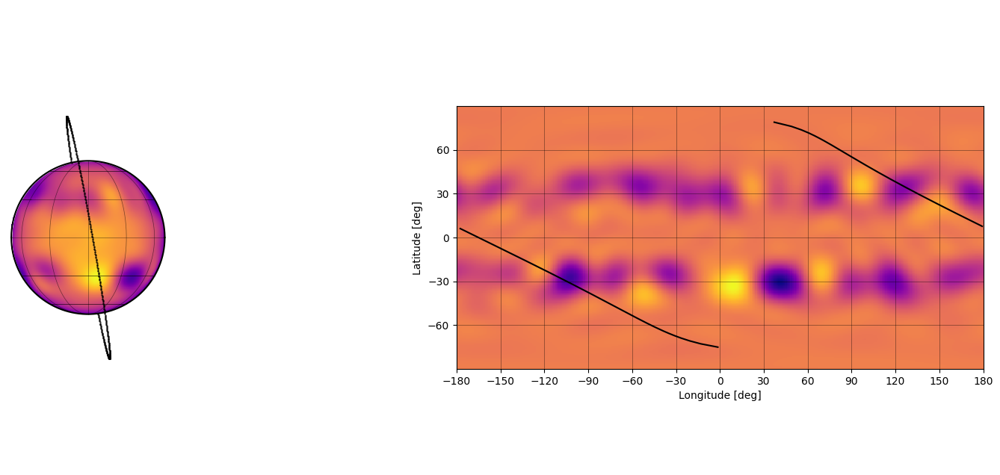

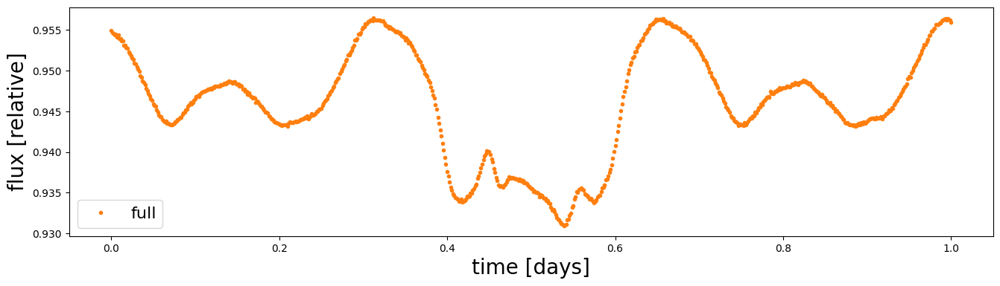

In [4]:
# *** True parameters & priors
params = {
    "planet.inc": {"truth": 88.0, "dist": Inclination},
    "planet.ecc": {"truth": 0.0, "dist": Uniform, "args": [0.0, 0.4]},
    "planet.Omega": {"truth": 100, "dist": Angle},
    "planet.w": {"truth": 0.0, "dist": Angle},
    "planet.porb": {"truth": 1.0, "dist": Uniform, "args": [0.975, 1.025]},
    "planet.t0": {"truth": 0.5, "dist": Uniform, "args": [0.475, 0.525]},
    "planet.r": {"truth": 0.1, "dist": Uniform, "args": [0.06, 0.14]},
    "star.inc": {"truth": 90, "dist": Inclination},
    "star.m": {"truth": 0.5, "dist": Uniform, "args": [0.4, 0.6]},
    "star.u1": {"truth": 0.4, "dist": Uniform, "args": [0.0, 0.6]},
    "star.u2": {"truth": 0.2, "dist": Uniform, "args": [0.0, 0.4]},
    "star.prot": {"truth": 0.34, "dist": pm.Uniform, "args": [0.1, 1.0]},
    "gp.r": {"truth": 10, "dist": Uniform, "args": [5.0, 25.0]},
    "gp.c": {"truth": 0.1, "dist": Uniform, "args": [0.01, 0.5]},
    "gp.n": {"truth": 20, "dist": Uniform, "args": [1, 30]},
    "gp.mu": {"truth": 30, "dist": Uniform, "args": [0.0, 80.0]},
    "gp.sigma": {"truth": 5, "dist": Uniform, "args": [1.0, 10]},
    "gp.norm": {"truth": 1, "dist": Uniform, "args": [0.8, 1.2]}
}

# *** Time array (1 day @ 2 min cadence)
t = np.arange(0, 1, 2 / 24 / 60)

# Get the light curve
flux, err, med_flux, mu_flux = generate(t, params, error=1e-4)


# Plot the data
fig, ax = plt.subplots(1, figsize=(16, 4))
ax.plot(t, flux, "C1.", alpha=1, label="full")
ax.set_ylabel("flux [relative]", fontsize=20)
ax.set_xlabel("time [days]", fontsize=20)
ax.legend(fontsize=16);

In [5]:
def parameter(name):
    param = params[name]
    if param.get("free", False):
        args = param.get("args", [])
        kwargs = param.get("kwargs", {})
        testval = param.get("testval", param["truth"])
        return param["dist"](name, *args, testval=testval, **kwargs)
    else:
        return param["truth"]

In [6]:
starry.config.lazy = True

In [227]:
# Instantiate the system
map = starry.Map(15, 2)
map.inc = params["star.inc"]["truth"]
map[1] = params["star.u1"]["truth"]
map[2] = params["star.u2"]["truth"]
star = starry.Primary(map, m=params["star.m"]["truth"]) # *** maybe also `r`
planet = starry.Secondary(
    starry.Map(),
    inc=params["planet.inc"]["truth"],
    ecc=params["planet.ecc"]["truth"],
    Omega=params["planet.Omega"]["truth"],
    w=params["planet.w"]["truth"],
    porb=params["planet.porb"]["truth"],
    t0=params["planet.t0"]["truth"],
)
sys = starry.System(star, planet)
xo, yo, zo = sys.position(t)
xo = xo.eval()[1]
yo = yo.eval()[1]
zo = zo.eval()[1]

# Get the flux design matrix
theta = (360 * t / params["star.prot"]["truth"]) % 360
A = map.design_matrix(
    theta=theta, xo=xo, yo=yo, zo=zo, ro=params["planet.r"]["truth"]
).eval()
print(A.shape)

# *** Draw 1 sample from the GP
sp = StarryProcess(
    mu=params["gp.mu"]["truth"],
    sigma=params["gp.sigma"]["truth"],
    r=params["gp.r"]["truth"],
    c=params["gp.c"]["truth"],
    n=params["gp.n"]["truth"],
    marginalize_over_inclination=False,  
    normalized=False,
)

Sigma_s = sp.cov_ylm 
mu_ylm = sp.mean_ylm
# mu_ylm = tt.inc_subtensor(mu_ylm[0], 1)
mu_flux = tt.dot(A, mu_ylm) #/ norm
K = len(t)

U = np.eye(256) +tt.dot(Sigma_s, tt.dot(A.T, A/tt.square(err[:,None])))

log_sigmadet = 2*tt.sum(tt.log(err)) + pmm.logdet(U) 
# log_sigmadet -= 2*256*tt.log(norm)

r = tt.as_tensor_variable(flux) - mu_flux
v = tt.dot(A.T,(r/tt.square(err)))
Q = tt.sum(tt.square(r/err)) - tt.dot(v.T,tt.slinalg.solve(U,tt.dot(v,Sigma_s)))

loglike = -0.5 * Q
loglike -= 0.5  * log_sigmadet
loglike -= 0.5 * K * tt.log(2 * np.pi)


(721, 256)


In [228]:
loglike.eval()

array(-947875.85216102)

In [229]:
y = sp.sample_ylm().eval().reshape(-1)

In [230]:
y[0]+=1

In [231]:
map[:,:] = y

In [232]:
lat, lon, Y2P, P2Y, Dx, Dy = map.get_pixel_transforms()

In [234]:
p = Y2P.dot(y)

In [233]:
cov_pix = sp.cov_pix(latlon=np.concatenate((lon, lat)).reshape(len(lon),2, order='F')).eval()

In [235]:
cov_pix.shape

(576, 576)

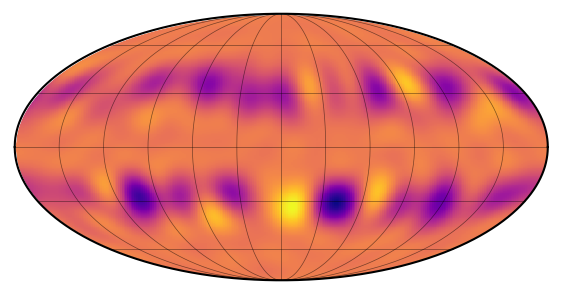

In [236]:
map.show(projection="moll")

In [15]:
p.shape

(576,)

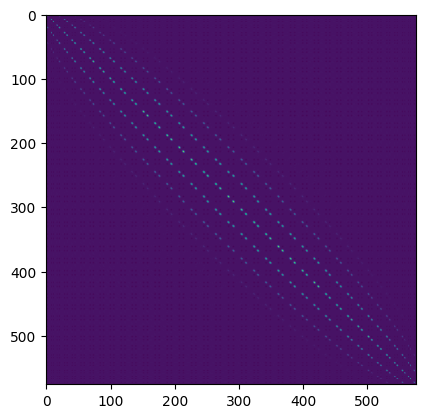

In [237]:
plt.imshow(cov_pix)

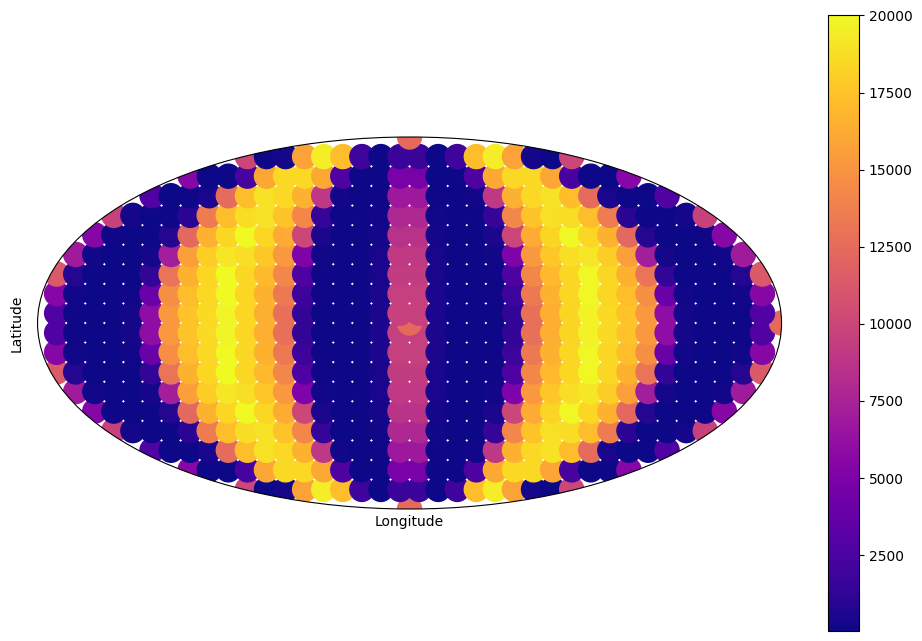

In [238]:
fig = plt.figure(figsize=(12, 8))
ax = fig.add_subplot(111, projection='mollweide')
cax = ax.scatter(np.deg2rad(lon), np.deg2rad(lat), c=np.diag(1/cov_pix), s=300, cmap='plasma')
# ax.grid(True)
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
ax.set_yticklabels([])
ax.set_xticklabels([])
cbar = fig.colorbar(cax, orientation='vertical')
plt.show()

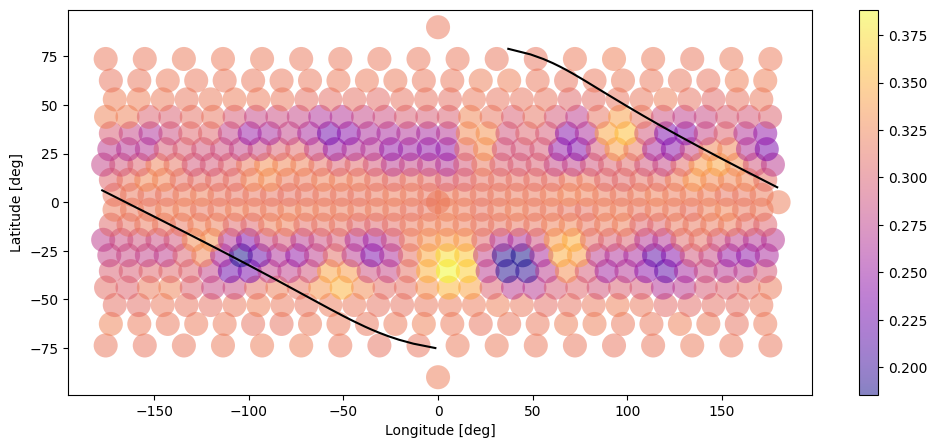

In [178]:
fig, ax = plt.subplots(1, figsize=(12, 5))
im = ax.scatter(lon, lat, s=300, c=p, ec="none", cmap="plasma", alpha=0.5)
idx = (zo > 0) & (xo ** 2 + yo ** 2 < 1)

lat_p = 180 / np.pi * np.arcsin(yo[idx])
lon_p = 180 / np.pi * np.arcsin(xo[idx] / np.sqrt(1 - yo[idx] ** 2)) - theta[idx]
lon_p = (lon_p + 180) % 360 - 180

mask = np.append(np.array(lon_p[1:] > lon_p[:-1], dtype=float), 0)
mask[mask == 1] = np.nan

# im = ax.scatter(lon, lat, s=300, c=p, alpha=0.5, ec="none", cmap="plasma")
ax.plot(lon_p, lat_p + mask, "k-");

cov_pix_p = sp.cov_pix(latlon=np.concatenate((lon_p, lat_p)).reshape(len(lon_p),2, order='F')).eval()

plt.colorbar(im)
# ax.set_xlim(-190, 190)
# ax.set_ylim(-90, 90)
ax.set_xlabel("Longitude [deg]")
ax.set_ylabel("Latitude [deg]");

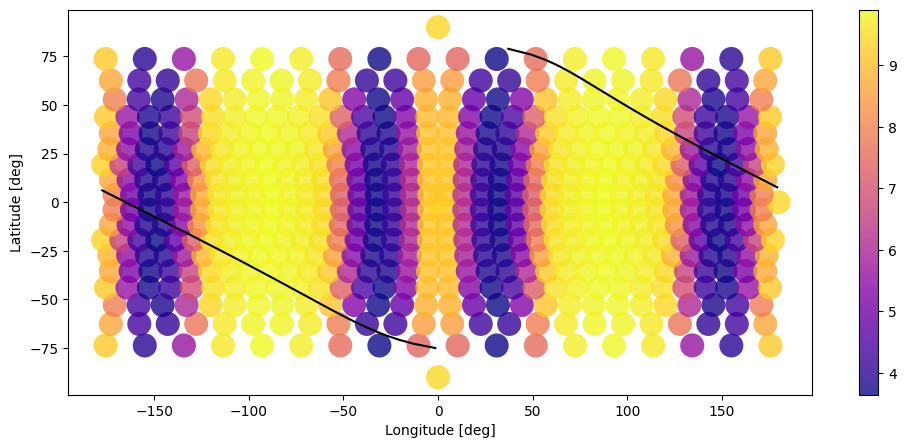

In [240]:
fig, ax = plt.subplots(1, figsize=(12, 5))
# im = ax.scatter(lon, lat, s=300, c=np.log(np.diag(scipy.linalg.inv(cov_pix))), ec="none", cmap="plasma", alpha=0.8)
im = ax.scatter(lon, lat, s=300, c=np.log(np.diag(1/cov_pix)), ec="none", cmap="plasma", alpha=0.8)
idx = (zo > 0) & (xo ** 2 + yo ** 2 < 1)

lat_p = 180 / np.pi * np.arcsin(yo[idx])
lon_p = 180 / np.pi * np.arcsin(xo[idx] / np.sqrt(1 - yo[idx] ** 2)) - theta[idx]
lon_p = (lon_p + 180) % 360 - 180

mask = np.append(np.array(lon_p[1:] > lon_p[:-1], dtype=float), 0)
mask[mask == 1] = np.nan

# im = ax.scatter(lon, lat, s=300, c=p, alpha=0.5, ec="none", cmap="plasma")
ax.plot(lon_p, lat_p + mask, "k-");

cov_pix_p = sp.cov_pix(latlon=np.concatenate((lon_p, lat_p)).reshape(len(lon_p),2, order='F')).eval()

plt.colorbar(im)
# ax.set_xlim(-190, 190)
# ax.set_ylim(-90, 90)
ax.set_xlabel("Longitude [deg]")
ax.set_ylabel("Latitude [deg]");

In [256]:
cov_pix.shape

(576, 576)

In [259]:
cov_pix_inv = scipy.linalg.inv(cov_pix)

In [266]:
cov_pix_inv.max()

1.4116211131225814e+20

/var/folders/6b/q0ls5s7570d8s04fbvw5gmxw0000gn/T/ipykernel_54833/275718291.py:4: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  im = ax.pcolormesh(lon, lat, cov_pix_inv, cmap="plasma", shading='nearest', norm=norm)


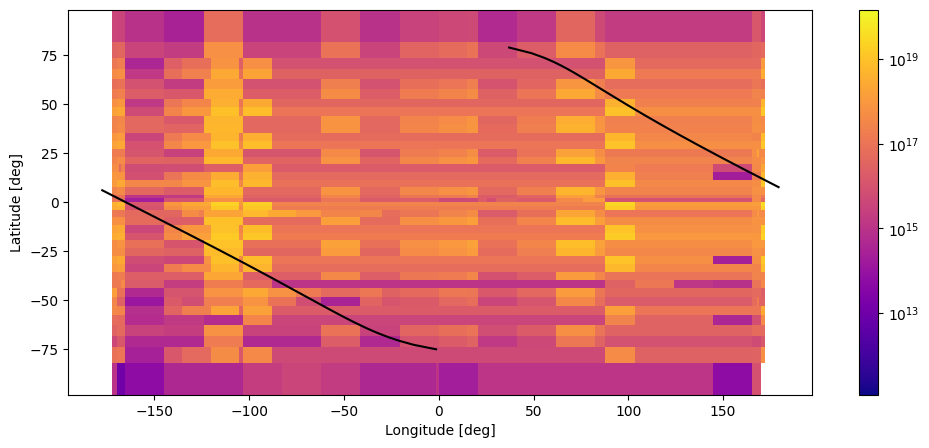

In [270]:
fig, ax = plt.subplots(1, figsize=(12, 5))
# im = ax.scatter(lon, lat, s=300, c=np.log(np.diag(scipy.linalg.inv(cov_pix))), ec="none", cmap="plasma", alpha=0.8)
norm = matplotlib.colors.LogNorm()
im = ax.pcolormesh(lon, lat, cov_pix_inv, cmap="plasma", shading='nearest', norm=norm)
idx = (zo > 0) & (xo ** 2 + yo ** 2 < 1)

lat_p = 180 / np.pi * np.arcsin(yo[idx])
lon_p = 180 / np.pi * np.arcsin(xo[idx] / np.sqrt(1 - yo[idx] ** 2)) - theta[idx]
lon_p = (lon_p + 180) % 360 - 180

mask = np.append(np.array(lon_p[1:] > lon_p[:-1], dtype=float), 0)
mask[mask == 1] = np.nan

# im = ax.scatter(lon, lat, s=300, c=p, alpha=0.5, ec="none", cmap="plasma")
ax.plot(lon_p, lat_p + mask, "k-");

plt.colorbar(im)
# ax.set_xlim(-190, 190)
# ax.set_ylim(-90, 90)
ax.set_xlabel("Longitude [deg]")
ax.set_ylabel("Latitude [deg]");

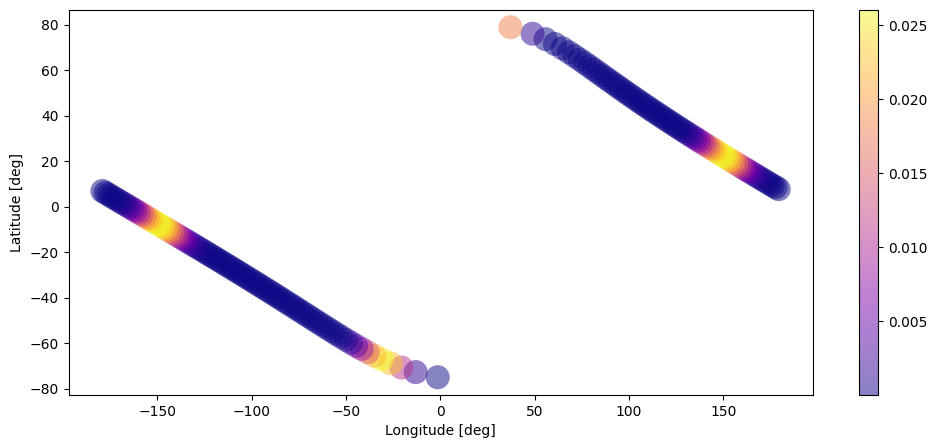

In [114]:
fig, ax = plt.subplots(1, figsize=(12, 5))
im = ax.scatter(lon_p, lat_p, s=300, c=np.diag(cov_pix_p), ec="none", cmap="plasma", alpha=0.5)
# ax.pcolormesh(lon, lat, cov_pix.T)


plt.colorbar(im)
# ax.set_xlim(-190, 190)
# ax.set_ylim(-90, 90)
ax.set_xlabel("Longitude [deg]")
ax.set_ylabel("Latitude [deg]");

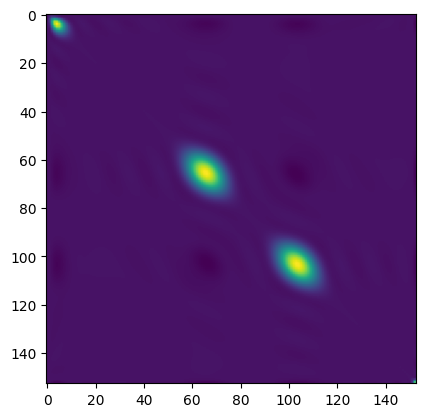

In [113]:
plt.imshow(cov_pix_p)

In [91]:
np.mean(cov_pix_p)

0.00036042773338653555

In [92]:
np.mean(cov_pix)

1.4877367389831177e-05

# Conditional samples:

In [11]:
nsamples = 100
cmap = plt.get_cmap("plasma")
norm = Normalize(vmin=0.5, vmax=1.1)

# Instantiate the system
map = starry.Map(15, 2)
map.inc = parameter("star.inc")
map[1] = parameter("star.u1")
map[2] = parameter("star.u2")
star = starry.Primary(map, m=parameter("star.m"))
planet = starry.Secondary(
    starry.Map(),
    inc=parameter("planet.inc"),
    ecc=parameter("planet.ecc"),
    Omega=parameter("planet.Omega"),
    w=parameter("planet.w"),
    porb=parameter("planet.porb"),
    t0=parameter("planet.t0"),
)
sys = starry.System(star, planet)
xo, yo, zo = sys.position(t)
xo = xo.eval()[1]
yo = yo.eval()[1]
zo = zo.eval()[1]

# Get the flux design matrix
theta = (360 * t / parameter("star.prot")) % 360
# *** Draw 1 sample from the GP
sp = StarryProcess(
    mu=parameter("gp.mu"),
    sigma=parameter("gp.sigma"),
    r=parameter("gp.r"),
    c=parameter("gp.c"),
    n=parameter("gp.n"),
    marginalize_over_inclination=False,  
    normalized=False,
)

y_samp = sp.sample_ylm_conditional(t=t, flux=flux, data_cov=err**2, nsamples=nsamples, baseline_mean=1, p=parameter("star.prot"),i=parameter("star.inc"), 
                                   u=(parameter("star.u1"), parameter("star.u2"))).eval()

# y_samp = sp.sample_ylm(nsamples=nsamples).eval()

# Normalize so that the background photosphere
# has unit intensity (for plotting)
y_samp[:,0] += 1
y_samp *= np.pi

/var/folders/6b/q0ls5s7570d8s04fbvw5gmxw0000gn/T/ipykernel_45314/1080153704.py:28: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_fontsize(6)


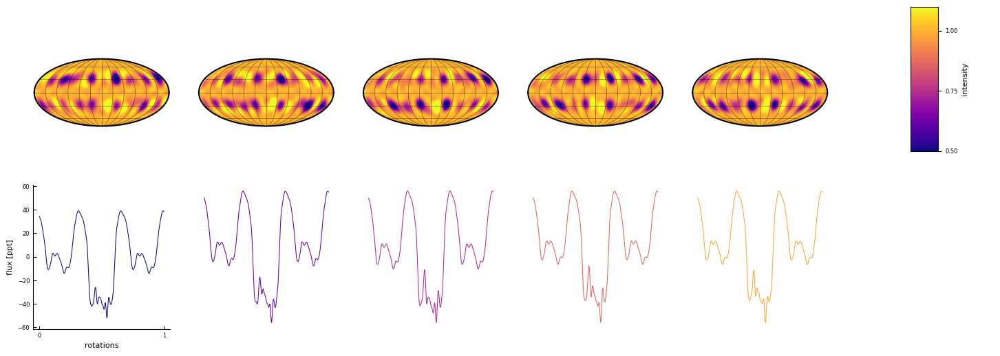

In [25]:
fig, ax = plt.subplots(
    2 * 1,
    nsamples + 1,
    figsize=(18, 6),
)

for k in range(nsamples):
    map[:, :] = y_samp[k]
    map.show(ax=ax[0, k], projection="moll", norm=norm)
    ax[0, k].set_ylim(-1.5, 2.25)
    ax[0, k].set_rasterization_zorder(1)
        
    flux_samp = map.flux(theta=theta, xo=xo, yo=yo, zo=zo, ro=parameter("planet.r")).eval()
    flux_samp -= np.mean(flux_samp)
    flux_samp *= 1e3
    ax[1, k].plot(t, flux_samp, color=cmap(k/5), lw=0.75)

    if k == 0:
        ax[1, k].spines["top"].set_visible(False)
        ax[1, k].spines["right"].set_visible(False)
        ax[1, k].set_xlabel("rotations", fontsize=8)
        ax[1, k].set_ylabel("flux [ppt]", fontsize=8)
        ax[1, k].set_xticks([0, 1])
        for tick in (
            ax[1, k].xaxis.get_major_ticks()
            + ax[1, k].yaxis.get_major_ticks()
        ):
            tick.label.set_fontsize(6)
        ax[1, k].tick_params(direction="in")
    else:
        ax[1, k].axis("off")


cax = inset_axes(
    ax[0, -1], width="20%", height="100%", loc="lower center"
)
cbar = fig.colorbar(ax[0, k].images[0], cax=cax, orientation="vertical")
cbar.set_label("intensity", fontsize=8)
cbar.set_ticks([0.5, 0.75, 1])
cbar.ax.tick_params(labelsize=6)
ax[0, -1].axis("off")

ax[1, -1].axis("off")

dy = max([max(np.abs(ax[1, k].get_ylim())) for k in range(nsamples)])
for k in range(nsamples):
    ax[1, 0].set_ylim(-dy, dy)


In [ ]:
for k in range(nsamples):
    map[:, :] = y_samp[k]
    fig, ax = plt.subplots(1, figsize=(20, 8))
    filename = 'map-transit' + str(k)

    idx = (zo > 0) | (xo ** 2 + yo ** 2 > 1)
    # ax.plot(xo[idx], yo[idx], "k.", ms=1);
    extent = -180, 180, -90, 90
    map.show(ax=ax, file=filename, projection='moll', alpha=0.01)

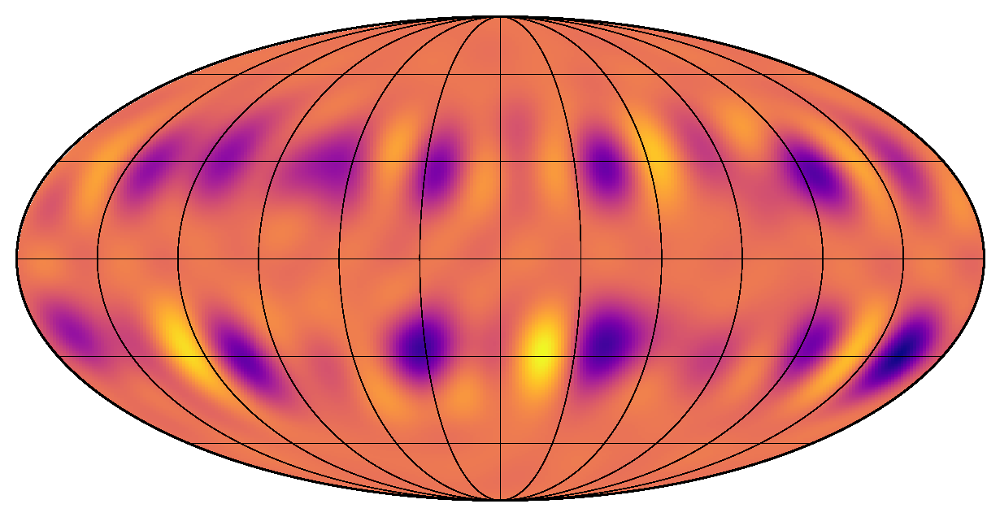

In [15]:
fig, ax = plt.subplots(1, figsize=(20, 8), frameon=False)
for k in range(nsamples):
    map[:, :] = y_samp[k]

    idx = (zo > 0) | (xo ** 2 + yo ** 2 > 1)
    # ax.plot(xo[idx], yo[idx], "k.", ms=1);
    extent = -180, 180, -90, 90
    map.show(ax=ax, projection='moll', alpha=0.01, extent=extent)

In [22]:
#!/usr/bin/env python3
import gc
import logging
import subprocess
import sys
import tempfile
from pathlib import Path

import numpy as np

def make_animation(frame_rate: float) -> None:
    print("Rendering animation...")
    subprocess.run(
        [
            "/Users/sabina/Downloads/ffmpeg",
            "-y",
            "-r",
            str(frame_rate),
            "-pattern_type",
            "glob",
            "-i",
            "*.png",
            *"-c:v libx264 -pix_fmt yuv420p -vf".split(),
            "fps=30, pad=ceil(iw/2)*2:ceil(ih/2)*2",
            "out.mp4",
        ],
        check=True,
    )


# for path in sorted(Path("castro_outputs").glob("v_*_drho_*")):
make_animation(frame_rate=6)

Rendering animation...


ffmpeg version N-106378-gfa989df1c6-tessus  https://evermeet.cx/ffmpeg/  Copyright (c) 2000-2022 the FFmpeg developers
  built with Apple clang version 11.0.0 (clang-1100.0.33.17)
  configuration: --cc=/usr/bin/clang --prefix=/opt/ffmpeg --extra-version=tessus --enable-avisynth --enable-fontconfig --enable-gpl --enable-libaom --enable-libass --enable-libbluray --enable-libdav1d --enable-libfreetype --enable-libgsm --enable-libmodplug --enable-libmp3lame --enable-libmysofa --enable-libopencore-amrnb --enable-libopencore-amrwb --enable-libopenh264 --enable-libopenjpeg --enable-libopus --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvmaf --enable-libvo-amrwbenc --enable-libvorbis --enable-libvpx --enable-libwebp --enable-libx264 --enable-libx265 --enable-libxavs --enable-libxvid --enable-libzimg --enable-libzmq --enable-libzvbi --enable-version3 --pkg-config-flags=--static

In [ ]:
for k in range(nsamples):
    fig, ax = plt.subplots(1, figsize=(20, 8))
    filename = 'rect_map' + str(k)

    idx = (zo > 0) & (xo ** 2 + yo ** 2 < 1)
    lat = 180 / np.pi * np.arcsin(yo[idx])
    lon = 180 / np.pi * np.arcsin(xo[idx] / np.sqrt(1 - yo[idx] ** 2)) - theta[idx]
    lon = (lon + 180) % 360 - 180
    mask = np.append(np.array(lon[1:] > lon[:-1], dtype=float), 0)
    mask[mask == 1] = np.nan
    ax.plot(lon, lat + mask, "k-");
    map.show(ax=ax, projection="rect", norm=norm, file=filename)


In [14]:
y_samp.shape

(5, 256)

In [54]:
Sigma_y = tt.slinalg.solve(U,Sigma_s).eval()
y_max = tt.slinalg.solve(U, (tt.dot(A.T, flux / tt.square(err[:,None])) + tt.slinalg.solve(Sigma_s, mu_ylm)[:,None])).eval()

In [16]:
Sigma_y.shape

(256, 256)

In [55]:
y_max.shape

(256, 721)

In [51]:
lmax = (15 + 1) ** 2
nsamples = 5
u = np.random.normal(np.mean(flux), 1e-3, (lmax,nsamples))
samples_cond = np.transpose(y_max.eval() + np.dot(Sigma_y, u))

ValueError: operands could not be broadcast together with shapes (256,721) (256,5) 

In [47]:
samples_cond

array(Elemwise{add,no_inplace}.0, dtype=object)

/var/folders/6b/q0ls5s7570d8s04fbvw5gmxw0000gn/T/ipykernel_34482/3240273.py:81: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_fontsize(6)


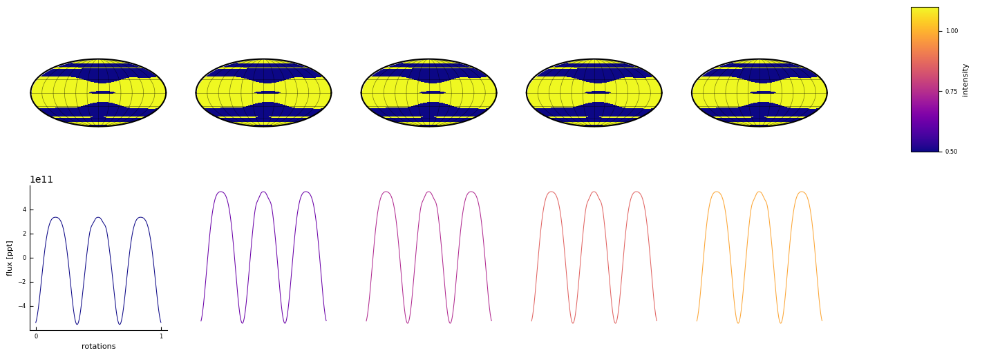

In [18]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import Normalize
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
from starry_process import StarryProcess
import starry
import os
from tqdm import tqdm

nsamples = 5
cmap = plt.get_cmap("plasma")
norm = Normalize(vmin=0.5, vmax=1.1)

# Instantiate the system
map = starry.Map(15, 2)
map.inc = parameter("star.inc")
map[1] = parameter("star.u1")
map[2] = parameter("star.u2")
star = starry.Primary(map, m=parameter("star.m")) 
planet = starry.Secondary(
    starry.Map(),
    inc=parameter("planet.inc"),
    ecc=parameter("planet.ecc"),
    Omega=parameter("planet.Omega"),
    w=parameter("planet.w"),
    porb=parameter("planet.porb"),
    t0=parameter("planet.t0"),
)
sys = starry.System(star, planet)
xo, yo, zo = sys.position(t)

# Get the flux design matrix
theta = (360 * t / parameter("star.prot")) % 360

fig, ax = plt.subplots(
    2 * 1,
    nsamples + 1,
    figsize=(18, 6),
)

sp = StarryProcess(
    mu=parameter('gp.mu'),
    sigma=parameter('gp.sigma'),
    r=parameter('gp.r'),
    c=parameter('gp.c'),
    n=parameter('gp.n'),
    marginalize_over_inclination=False,  # *** we know the inclination
    normalized=False,  # *** we're modeling the normalization explicitly
)

y_samp = samples_cond.copy()

# y_samp = sp.sample_ylm(nsamples=nsamples).eval()

# Normalize so that the background photosphere
# has unit intensity (for plotting)
y_samp[:,0] += 1
y_samp *= np.pi

for k in range(nsamples):
    map[:, :] = y_samp[k]
    map.show(ax=ax[0, k], projection="moll", norm=norm)
    ax[0, k].set_ylim(-1.5, 2.25)
    ax[0, k].set_rasterization_zorder(1)
        
    flux_samp = map.flux(theta=theta, xo=xo[1], yo=yo[1], zo=zo[1], ro=parameter("planet.r")).eval()
    flux_samp -= np.mean(flux_samp)
    flux_samp *= 1e3
    ax[1, k].plot(t, flux_samp, color=cmap(k/5), lw=0.75)

    if k == 0:
        ax[1, k].spines["top"].set_visible(False)
        ax[1, k].spines["right"].set_visible(False)
        ax[1, k].set_xlabel("rotations", fontsize=8)
        ax[1, k].set_ylabel("flux [ppt]", fontsize=8)
        ax[1, k].set_xticks([0, 1])
        for tick in (
            ax[1, k].xaxis.get_major_ticks()
            + ax[1, k].yaxis.get_major_ticks()
        ):
            tick.label.set_fontsize(6)
        ax[1, k].tick_params(direction="in")
    else:
        ax[1, k].axis("off")


cax = inset_axes(
    ax[0, -1], width="20%", height="100%", loc="lower center"
)
cbar = fig.colorbar(ax[0, k].images[0], cax=cax, orientation="vertical")
cbar.set_label("intensity", fontsize=8)
cbar.set_ticks([0.5, 0.75, 1])
cbar.ax.tick_params(labelsize=6)
ax[0, -1].axis("off")

# lax = inset_axes(
#     ax[1, -1], width="80%", height="100%", loc="center right"
# )
# lax.plot(0, 0, color=cmap(k/5), lw=1, label=r"{}$^\circ$".format(80))
# lax.legend(loc="center left", fontsize=5, frameon=False)
# lax.axis("off")
ax[1, -1].axis("off")

dy = max([max(np.abs(ax[1, k].get_ylim())) for k in range(nsamples)])
for k in range(nsamples):
    ax[1, 0].set_ylim(-dy, dy)


In [11]:
samples_fromfile1 = az.from_netcdf('sampler_64000_gps_samples.nc')

In [12]:
# transformed samples converted to numpy array for plotting purposes
samples_fromfile1 = samples_fromfile1.posterior.to_array()[0]

In [13]:
samples_dict = {}

In [14]:
p = dict(params)
p["gp.mu"]["free"] = True
p["gp.sigma"]["free"] = True
p["gp.n"]["free"] = True
p["gp.c"]["free"] = True
p["gp.r"]["free"] = True
p["gp.norm"]["free"] = True
free = [x for x in p.keys() if p[x].get("free", False)]

In [15]:
for n, i in enumerate(free):
    samples_dict[i] = np.array(samples_fromfile1)[:,n]

In [39]:
# Draw samples
rand_index = np.random.randint(0,np.array(samples_fromfile1).shape[0])

In [17]:
nsamples = 100
cmap = plt.get_cmap("plasma")
norm = Normalize(vmin=0.5, vmax=1.1)

# Instantiate the system
map = starry.Map(15, 2)
map.inc = params["star.inc"]["truth"]
map[1] = params["star.u1"]["truth"]
map[2] = params["star.u2"]["truth"]
star = starry.Primary(map, m=params["star.m"]["truth"]) # *** maybe also `r`
planet = starry.Secondary(
    starry.Map(),
    inc=params["planet.inc"]["truth"],
    ecc=params["planet.ecc"]["truth"],
    Omega=params["planet.Omega"]["truth"],
    w=params["planet.w"]["truth"],
    porb=params["planet.porb"]["truth"],
    t0=params["planet.t0"]["truth"],
)
sys = starry.System(star, planet)
xo, yo, zo = sys.position(t)
xo = xo.eval()[1]
yo = yo.eval()[1]
zo = zo.eval()[1]

# Get the flux design matrix
theta = (360 * t / params["star.prot"]["truth"]) % 360
# *** Draw 1 sample from the GP
# sp = StarryProcess(
#     mu=samples_dict['gp.mu'][rand_index],
#     sigma=samples_dict['gp.sigma'][rand_index],
#     r=samples_dict['gp.r'][rand_index],
#     c=samples_dict['gp.c'][rand_index],
#     n=samples_dict['gp.n'][rand_index],
#     marginalize_over_inclination=False,  
#     normalized=False, 
# )

# y_samp_posterior = sp.sample_ylm_conditional(t=t, flux=flux, data_cov=err**2, nsamples=nsamples, baseline_mean=1, p=params["star.prot"]["truth"],i=params["star.inc"]["truth"], 
#                                    u=(params["star.u1"]["truth"], params["star.u2"]["truth"])).eval()

# # y_samp = sp.sample_ylm(nsamples=nsamples).eval()

# # Normalize so that the background photosphere
# # has unit intensity (for plotting)
# y_samp_posterior[:,0] += 1
# y_samp_posterior *= np.pi

/var/folders/6b/q0ls5s7570d8s04fbvw5gmxw0000gn/T/ipykernel_56127/411505459.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(1, figsize=(20, 8))


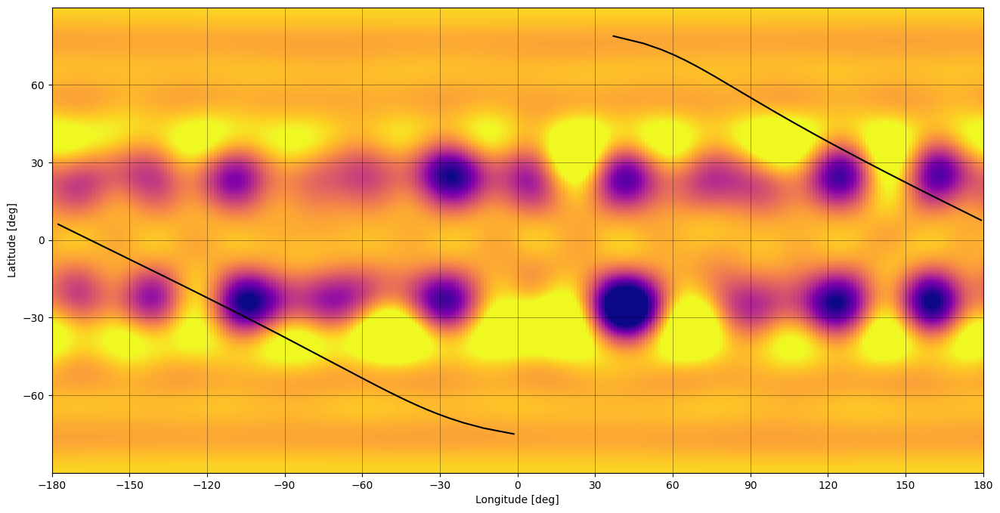

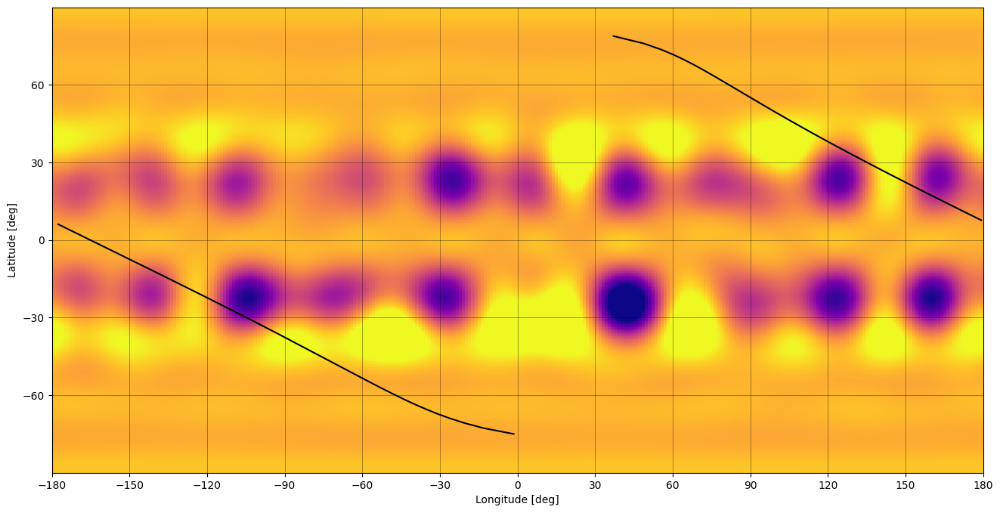

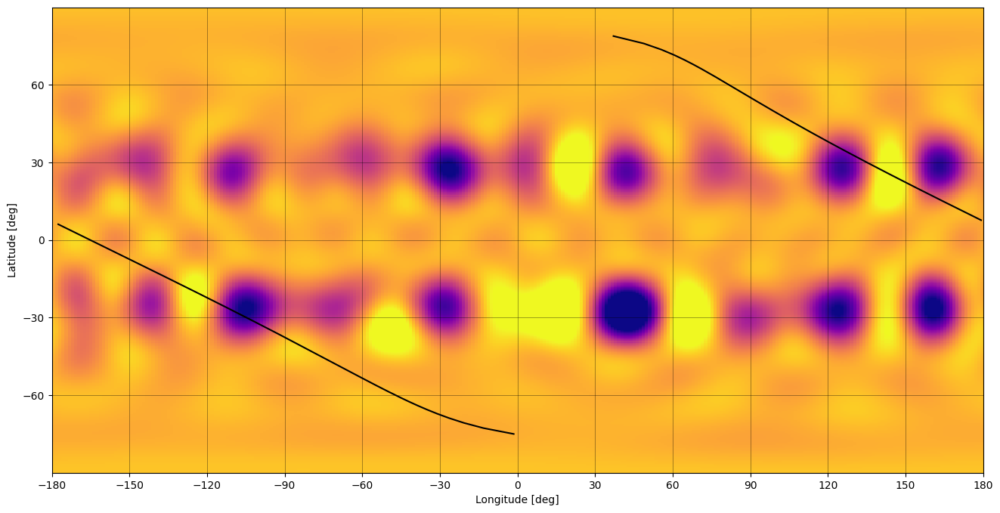

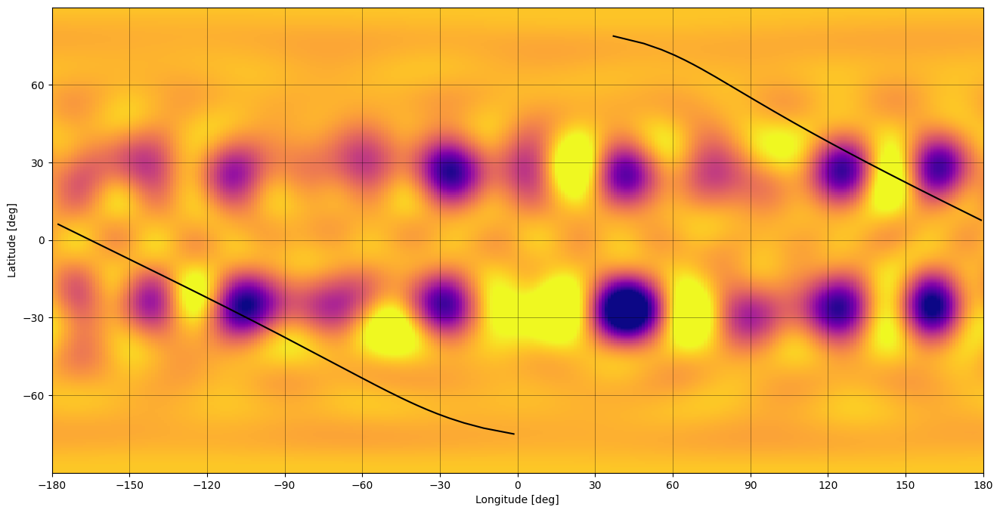

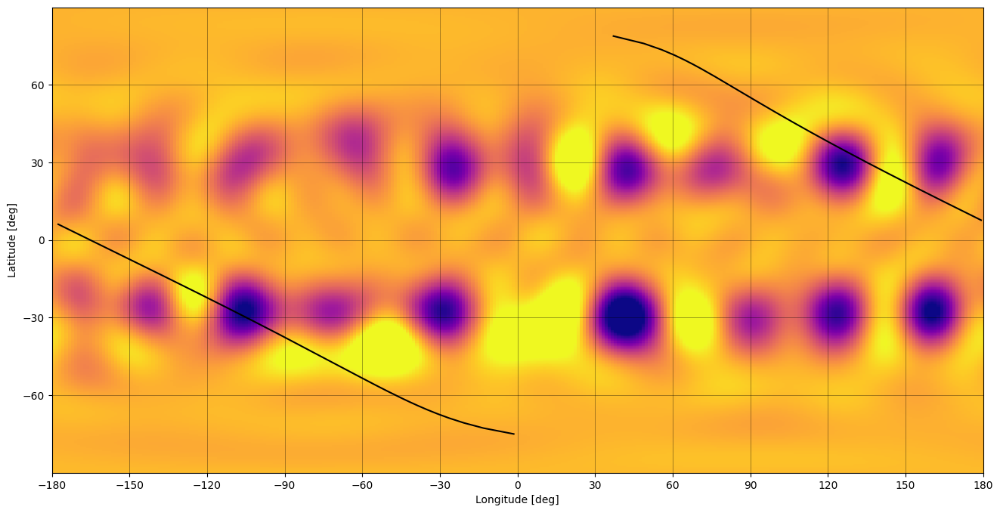

...

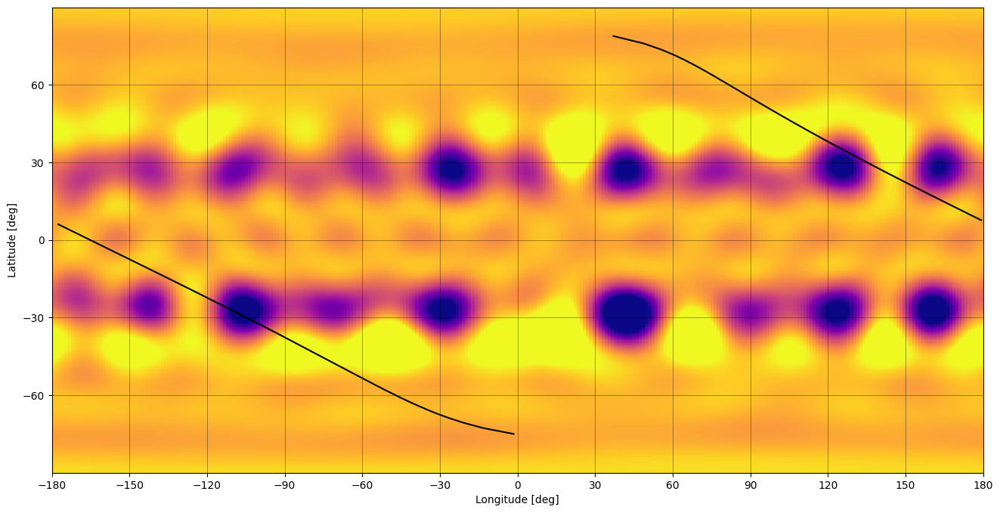

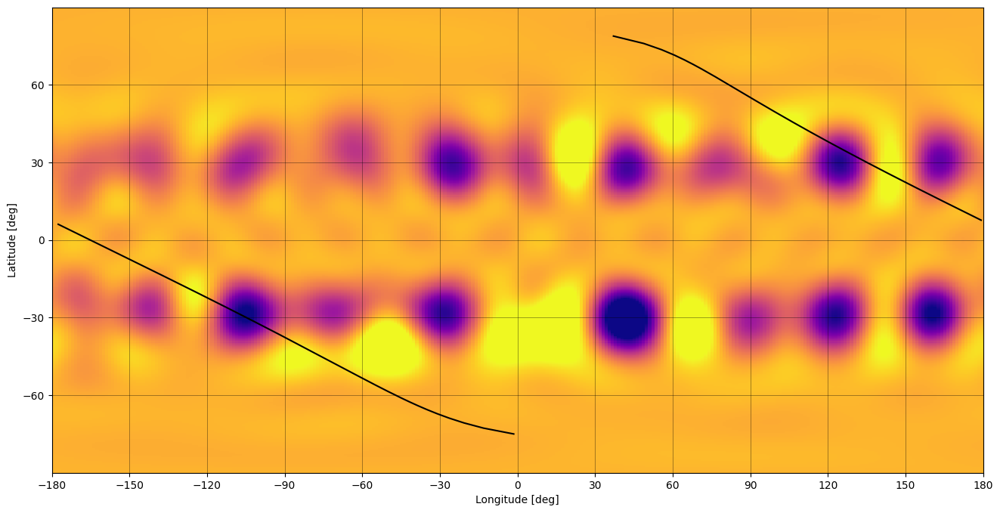

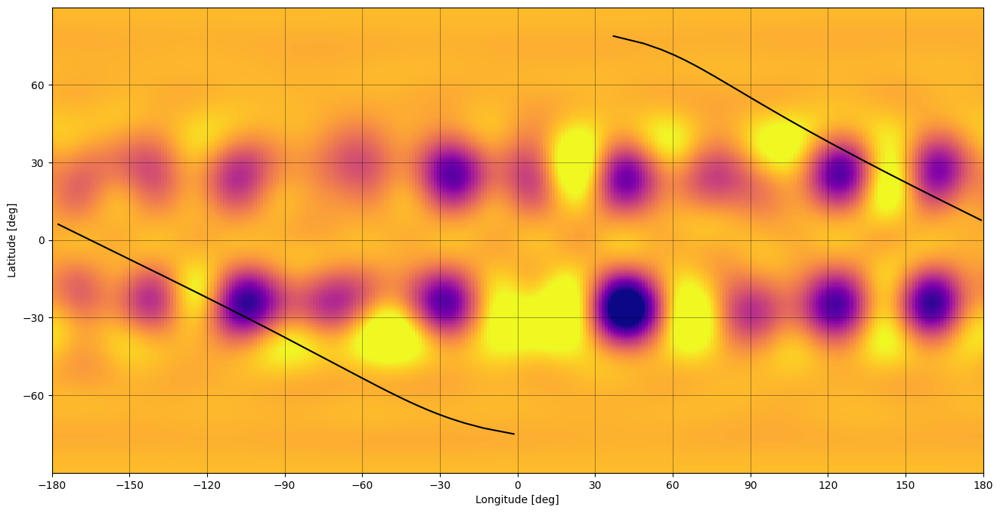

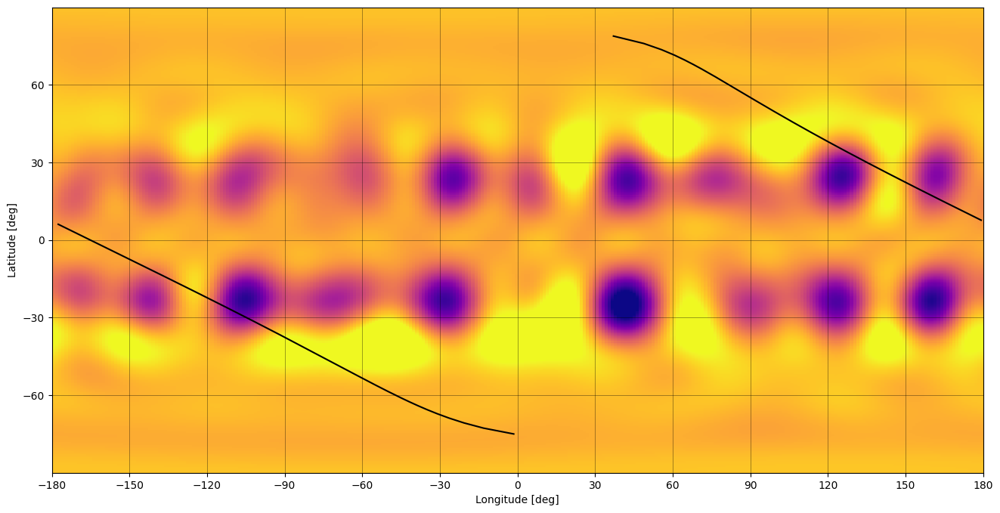

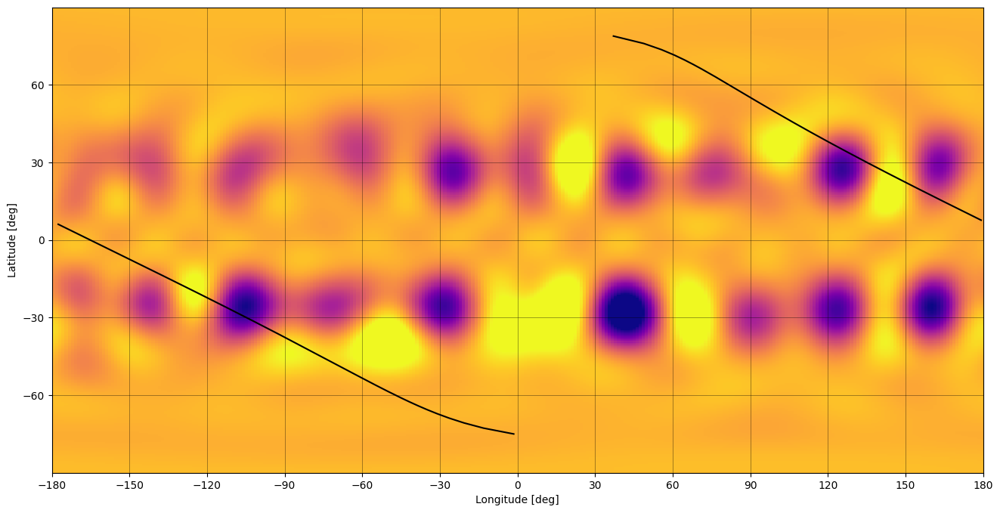

In [21]:
for k in range(nsamples):
    rand_index = np.random.randint(0,np.array(samples_fromfile1).shape[0])
    # *** Draw 1 sample from the GP
    sp = StarryProcess(
        mu=samples_dict['gp.mu'][rand_index],
        sigma=samples_dict['gp.sigma'][rand_index],
        r=samples_dict['gp.r'][rand_index],
        c=samples_dict['gp.c'][rand_index],
        n=samples_dict['gp.n'][rand_index],
        marginalize_over_inclination=False,  
        normalized=False, 
    )

    y_samp_posterior = sp.sample_ylm_conditional(t=t, flux=flux, data_cov=err**2, baseline_mean=1, p=params["star.prot"]["truth"],i=params["star.inc"]["truth"], 
                                    u=(params["star.u1"]["truth"], params["star.u2"]["truth"])).eval().reshape(-1)


    # Normalize so that the background photosphere
    # has unit intensity (for plotting)
    y_samp_posterior[0] += 1
    y_samp_posterior *= np.pi
    map[:, :] = y_samp_posterior
    fig, ax = plt.subplots(1, figsize=(20, 8))
    filename = 'map_posterior' + str(k)

    idx = (zo > 0) & (xo ** 2 + yo ** 2 < 1)
    

    lat = 180 / np.pi * np.arcsin(yo[idx])
    lon = 180 / np.pi * np.arcsin(xo[idx] / np.sqrt(1 - yo[idx] ** 2)) - theta[idx]
    lon = (lon + 180) % 360 - 180
    mask = np.append(np.array(lon[1:] > lon[:-1], dtype=float), 0)
    mask[mask == 1] = np.nan
    ax.plot(lon, lat + mask, "k-");
    map.show(ax=ax, projection="rect", norm=norm, file=filename)